## Procesamiento de Imagenes
Ejercicio 1: Espacios de Color

Usando una imagen a color de su elección:

a) Cargar la imagen con OpenCV y mostrar los canales BGR por separado.
b) Identificar cuál de los tres canales tiene mayor información basándose en los valores promedio.
c) Convertir la imagen de BGR a RGB y explicar por qué los colores se ven diferentes antes y después de la conversión.

Alumno: Eduardo Farfán

# Análisis de Espacios de Color con OpenCV

## 1. Introducción a los Espacios de Color

Las imágenes digitales a color se pueden representar de diferentes maneras. Los dos espacios de color más comunes en procesamiento digital de imágenes son:

RGB (Red, Green, Blue):
- Usado por la mayoría de dispositivos de visualización
- Cada pixel se representa con 3 valores (Rojo, Verde, Azul)
- Valores típicos entre 0-255 por canal

BGR (Blue, Green, Red):
- Formato utilizado por OpenCV
- Misma estructura que RGB pero con orden invertido
- Importante para evitar errores de interpretación


## 1. Instaló y cargo las librerias

In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow


## 2. Descarga de la imagen

Instale gdown dado que de la url original, arrojaba error con !wget, por eso opte instalar gdown, posteriormente descargue la imagen y subi a mi drive compartiendo el archivo

In [6]:
!pip install gdown

In [7]:
import gdown

url = "https://drive.google.com/uc?id=1WQsqiUy7oUQj7-JGXwNS8QhXLcPLEBDg"
output = "paisaje.jpeg"
gdown.download(url, output, quiet=False)


Downloading...
From: https://drive.google.com/uc?id=1WQsqiUy7oUQj7-JGXwNS8QhXLcPLEBDg
To: /content/paisaje.jpeg
100%|██████████| 1.28M/1.28M [00:00<00:00, 29.3MB/s]


'paisaje.jpeg'

## 3. Trabajando con OpenCV (cv2)

OpenCV es una biblioteca para el procesamiento de imágenes:
- Utiliza formato BGR por defecto


In [8]:
imagen_bgr = cv2.imread('paisaje.jpeg')
print(type(imagen_bgr))

<class 'numpy.ndarray'>


In [9]:
# Función para analizar características de la imagen
def info_img(img):
    print('tamaño =', img.shape)
    print('máximo =', np.max(img))
    print('mínimo =', np.min(img))
    print("Tamaño en memoria (bytes):", imagen_bgr.nbytes)


tamaño = (2847, 4226, 3)
máximo = 255
mínimo = 0
Tamaño en memoria (bytes): 36094266


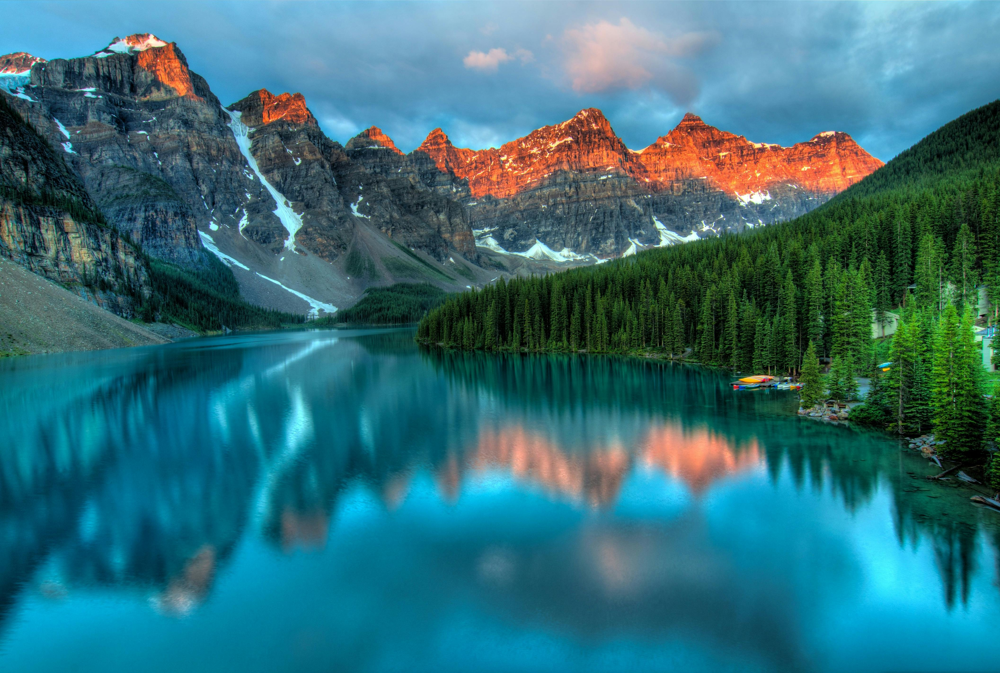

In [10]:
info_img(imagen_bgr)
# Visualización de la imagen completa
cv2_imshow(imagen_bgr)

Redimensione la imagen (512 x 512) dado que es un poco grande y con esto trato de evitar problemas de:

_ Tiempo de procesamiento

_ Visualización lenta

_ Uso innecesario de memoria

_ Dificultad para comparar imagenes en distintos canales dado su tamaño

In [11]:
imagen_bgr = cv2.resize(imagen_bgr, (512, 512))
print("Dimensiones de la imagen:", imagen_bgr.shape)
print("Tipo de datos:", imagen_bgr.dtype)
print("Tamaño en memoria (bytes):", imagen_bgr.nbytes)

Dimensiones de la imagen: (512, 512, 3)
Tipo de datos: uint8
Tamaño en memoria (bytes): 786432


# Visualización de la imagen completa (en formato BGR)


Imagen original en formato BGR:


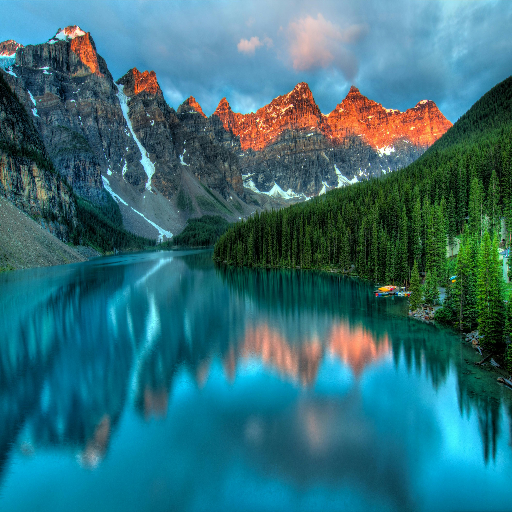

In [12]:
print("\nImagen original en formato BGR:")
cv2_imshow(imagen_bgr)

## 4. Análisis de Canales BGR por separado

Cada canal representa la intensidad de un color específico:
- Valores cercanos a 0 indican ausencia del color
- Valores cercanos a 255 indican máxima intensidad


 a) Separar canales y mostrarlos individualmente
  - Canal Azul (B)


Canal Azul (B):
Valor mínimo: 0, Valor máximo: 255, Promedio: 120.91


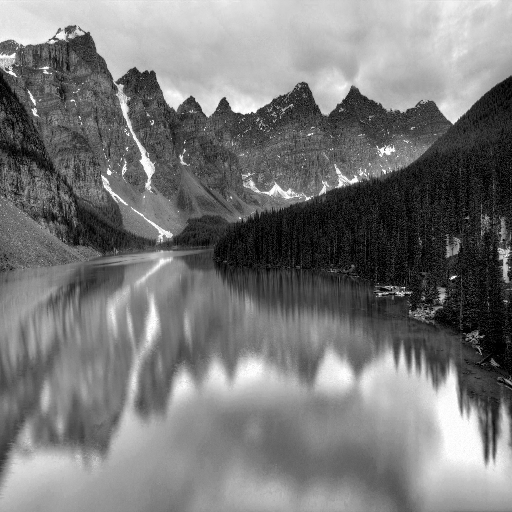

In [13]:
B = imagen_bgr[:,:,0]
print("\nCanal Azul (B):")
print(f"Valor mínimo: {B.min()}, Valor máximo: {B.max()}, Promedio: {B.mean():.2f}")
cv2_imshow(B)

# Canal Verde (G)



Canal Verde (G):
Valor mínimo: 0, Valor máximo: 255, Promedio: 111.14


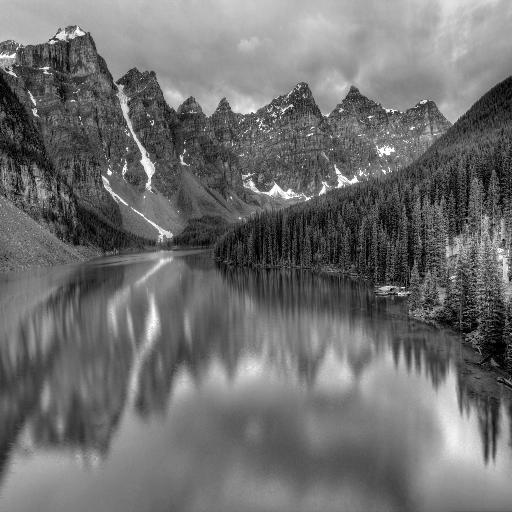

In [14]:
G = imagen_bgr[:,:,1]
print("\nCanal Verde (G):")
print(f"Valor mínimo: {G.min()}, Valor máximo: {G.max()}, Promedio: {G.mean():.2f}")
cv2_imshow(G)


# Canal Rojo (R)



Canal Rojo (R):
Valor mínimo: 0, Valor máximo: 255, Promedio: 51.24


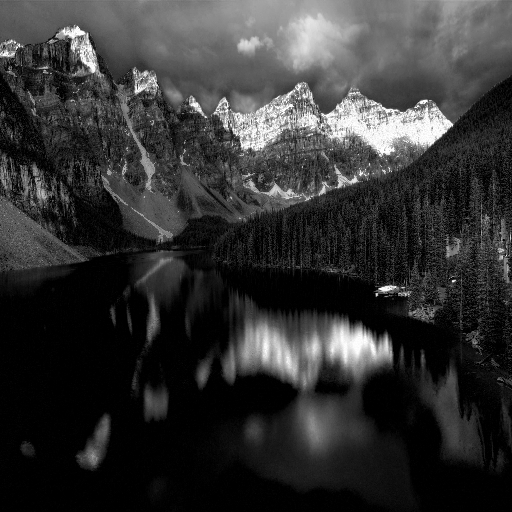

In [15]:
R = imagen_bgr[:,:,2]
print("\nCanal Rojo (R):")
print(f"Valor mínimo: {R.min()}, Valor máximo: {R.max()}, Promedio: {R.mean():.2f}")
cv2_imshow(R)

# Visualización usando matplotlib para mayor detalle

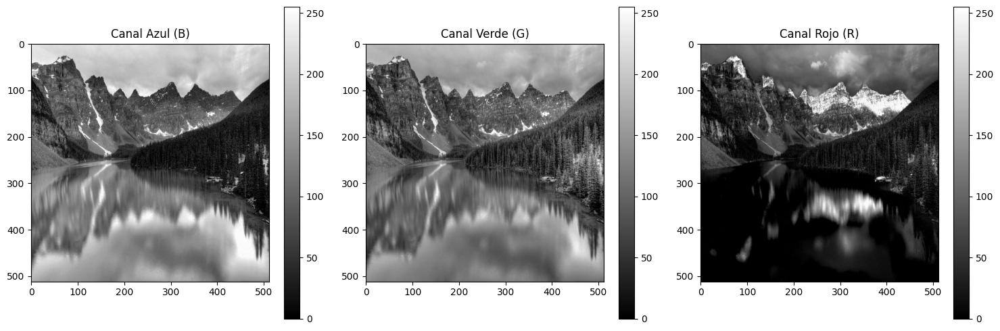

In [16]:

plt.figure(figsize=(15, 5))

plt.subplot(131)
plt.imshow(B, cmap='gray')
plt.title('Canal Azul (B)')
plt.colorbar()

plt.subplot(132)
plt.imshow(G, cmap='gray')
plt.title('Canal Verde (G)')
plt.colorbar()

plt.subplot(133)
plt.imshow(R, cmap='gray')
plt.title('Canal Rojo (R)')
plt.colorbar()

plt.tight_layout()
plt.show()


## 5. Se identifica el canal con mayor información

- b) Identificar cuál de los tres canales tiene mayor información basándose en valores promedio



In [17]:
print("\nAnálisis de valores promedio:")
print(f"Valor promedio del canal Azul (B): {B.mean():.2f}")
print(f"Valor promedio del canal Verde (G): {G.mean():.2f}")
print(f"Valor promedio del canal Rojo (R): {R.mean():.2f}")

# Determinar el canal con mayor información
valores_promedio = [B.mean(), G.mean(), R.mean()]
canales = ['Azul (B)', 'Verde (G)', 'Rojo (R)']
canal_max = canales[valores_promedio.index(max(valores_promedio))]

print(f"\nEl canal con mayor información basado en el valor promedio es: {canal_max}")



Análisis de valores promedio:
Valor promedio del canal Azul (B): 120.91
Valor promedio del canal Verde (G): 111.14
Valor promedio del canal Rojo (R): 51.24

El canal con mayor información basado en el valor promedio es: Azul (B)


# Visualización de histogramas para cada canal


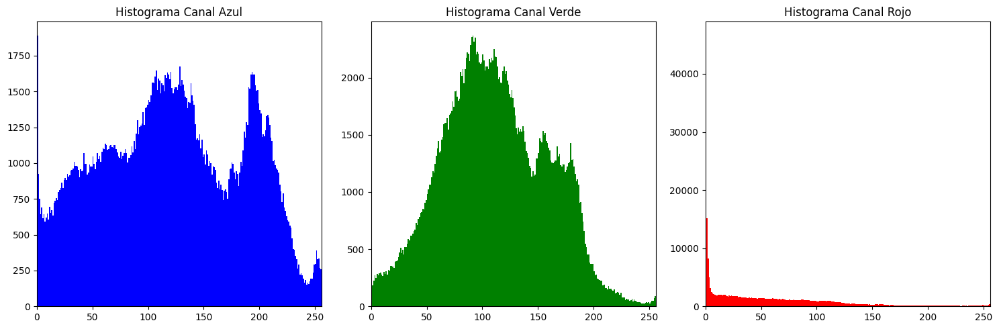

In [18]:
plt.figure(figsize=(15, 5))

plt.subplot(131)
plt.hist(np.ravel(B), bins=256, range=(0, 256), color='blue')
plt.title('Histograma Canal Azul')
plt.xlim([0, 256])

plt.subplot(132)
plt.hist(np.ravel(G), bins=256, range=(0, 256), color='green')
plt.title('Histograma Canal Verde')
plt.xlim([0, 256])

plt.subplot(133)
plt.hist(np.ravel(R), bins=256, range=(0, 256), color='red')
plt.title('Histograma Canal Rojo')
plt.xlim([0, 256])

plt.tight_layout()
plt.show()


##  Análisis de Histograma por Canal de Color (Paisaje)

Se analiza cada uno de los canales de color **BGR (Blue, Green, Red)** de la imagen, comparando la información visual con los resultados de su histograma.

---

### 🔵 Canal Azul (Blue)

#### 📈 Histograma:
- Picos altos entre valores de **50 a 200** y algunas caidas en 175.
- Distribución amplia en toda la gama (de tonos oscuros a claros).

#### 🖼️ Imagen:
- Dominio claro del **color turquesa en el lago**.
- Reflejos del cielo.
- Sombra azulada en árboles y deshielo de las montañas.

####  Conclusión:
> El canal azul es **el más dominante** en la imagen, lo cual observa en el histograma.

---

### 🟢 Canal Verde (Green)

#### 📈 Histograma:
- Pico importante en la zona media (entre **80 y 130**).
- Disminución progresiva después de los 150 con algunos picos.

#### 🖼️ Imagen:
- Gran presencia de **vegetación (árboles de pino)** en el paisaje.
- Parte del agua también contiene tonos verdosos al mezclarse con el azul.

####  Conclusión:
> El canal verde representa la **vegetación del entorno**. Aunque no tan dominante como el azul, sigue siendo muy importante.

---

### 🔴 Canal Rojo (Red)

#### 📈 Histograma:
- Intensidad baja.
- Valores concentrados cerca de **0 a 50**.

#### 🖼️ Imagen:
- El rojo aparece **sólo en los picos de las montañas**, iluminadas por el sol durante el atardecer/amanecer.
- Algo pequeño en comparación al resto del paisaje.

####  Conclusión:
> El canal rojo tiene **baja presencia**, lo cual se observa en el histograma.


# 6. Uso de Matplotlib (RGB)

Matplotlib ofrece funcionalidades más avanzadas de visualización:
- Usa formato RGB por defecto
- Permite personalización detallada de gráficos
- Ideal para presentación y análisis visual

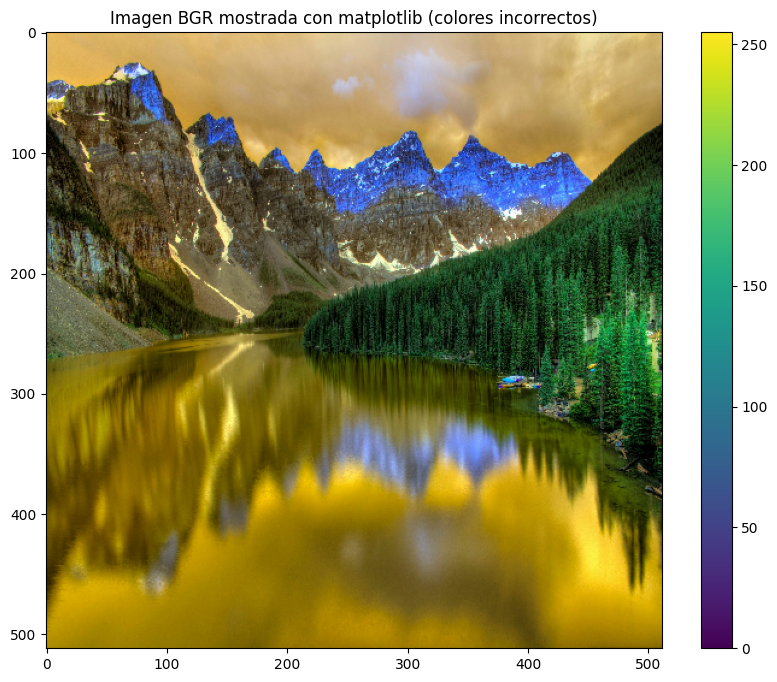

In [19]:
# Visualización de la imagen usando matplotlib (que espera formato RGB)
plt.figure(figsize=(10, 8))
plt.imshow(imagen_bgr)  # Nota: esto mostrará colores incorrectos, ya que matplotlib espera RGB
plt.title('Imagen BGR mostrada con matplotlib (colores incorrectos)')
plt.colorbar()
plt.show()

## 7. Conversión entre Espacios de Color


Es crucial entender cómo convertir entre BGR y RGB:
- Evita errores de interpretación
- Permite usar correctamente ambas bibliotecas


 c) Convertir la imagen de BGR a RGB y explicar las diferencias

In [20]:
imagen_rgb = cv2.cvtColor(imagen_bgr, cv2.COLOR_BGR2RGB)

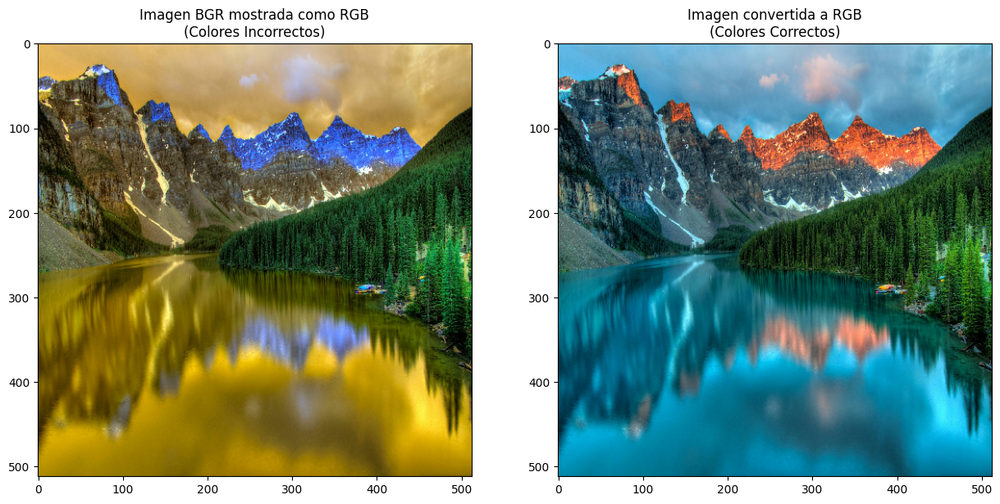

In [21]:
# Visualización comparativa
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

ax1.imshow(imagen_bgr)
ax1.set_title('Imagen BGR mostrada como RGB\n(Colores Incorrectos)')

ax2.imshow(imagen_rgb)
ax2.set_title('Imagen convertida a RGB\n(Colores Correctos)')

plt.show()


# Explicación de las diferencias


1. Orden de canales:
   - BGR (OpenCV): Blue-Green-Red
   - RGB (Matplotlib): Red-Green-Blue

2. Cuando mostramos una imagen BGR directamente con matplotlib:
   - El canal azul (B) se muestra en la posición del rojo
   - El canal verde (G) permanece en su posición
   - El canal rojo (R) se muestra en la posición del azul
   
   Esto produce una inversión de colores donde los tonos rojos aparecen azulados y viceversa.

3. La función cv2.cvtColor(imagen_bgr, cv2.COLOR_BGR2RGB) corrige este problema:
   - Intercambia los canales R y B
   - Permite que la imagen se visualice correctamente en matplotlib

Al mostrar la imagen con matplotlib, los colores no coinciden con los reales (el cielo puede verse beige, por ejemplo).

Después de la conversión a RGB: los colores se visualizan correctamente.

La conversión BGR → RGB es necesaria para una representación visual correcta al usar bibliotecas como matplotlib.


# Visualización detallada de canales RGB


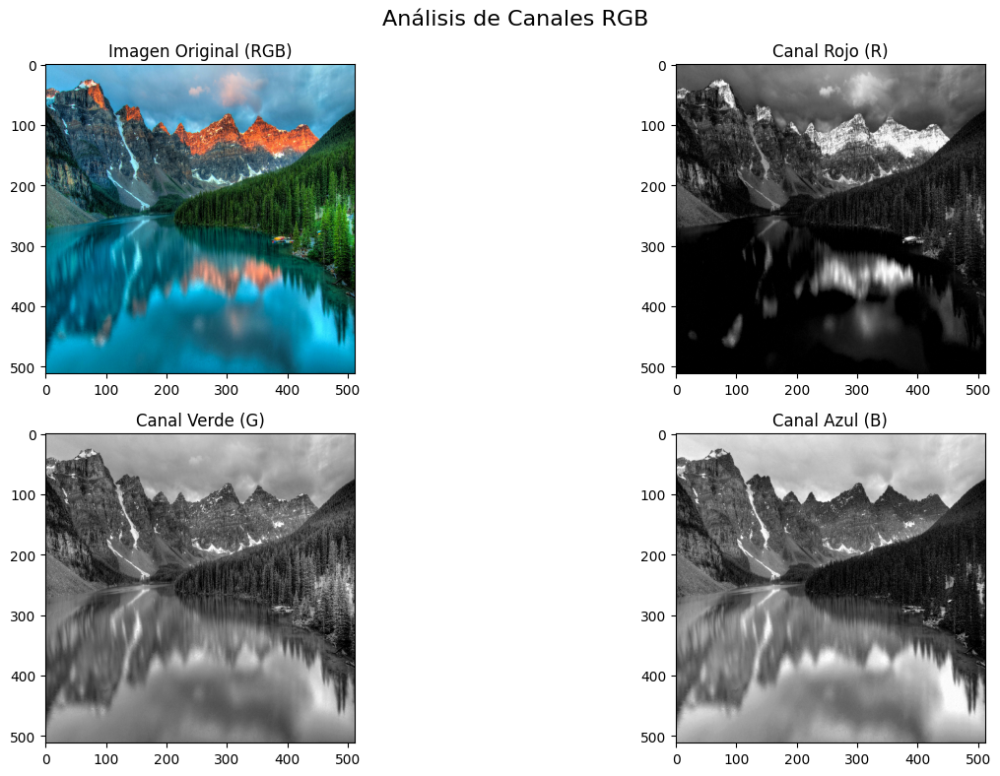

In [22]:
fig, axes = plt.subplots(2, 2, figsize=(15, 8))
fig.suptitle('Análisis de Canales RGB', fontsize=16)

# Imagen Original (RGB correcta)
axes[0, 0].imshow(imagen_rgb)
axes[0, 0].set_title('Imagen Original (RGB)')

# Canal Rojo
axes[0, 1].imshow(imagen_rgb[:,:,0], cmap='gray')
axes[0, 1].set_title('Canal Rojo (R)')

# Canal Verde
axes[1, 0].imshow(imagen_rgb[:,:,1], cmap='gray')
axes[1, 0].set_title('Canal Verde (G)')

# Canal Azul
axes[1, 1].imshow(imagen_rgb[:,:,2], cmap='gray')
axes[1, 1].set_title('Canal Azul (B)')

plt.tight_layout()
plt.show()



## 8. Verificación de intercambio de canales

-  Comprobación de que B y R se han intercambiado


In [23]:
print("Comprobación: ¿El canal B de BGR es igual al canal R de RGB?")
print(f"Igualdad: {np.array_equal(B, imagen_rgb[:,:,2])}")

print("Comprobación: ¿El canal R de BGR es igual al canal B de RGB?")
print(f"Igualdad: {np.array_equal(R, imagen_rgb[:,:,0])}")


Comprobación: ¿El canal B de BGR es igual al canal R de RGB?
Igualdad: True
Comprobación: ¿El canal R de BGR es igual al canal B de RGB?
Igualdad: True


Al convertir una imagen de BGR a RGB con `cv2.cvtColor`, se intercambian los canales Azul y Rojo:

| Canal BGR | Canal RGB |
|-----------|------------|
| 🔵 Azul   | 🔴 Rojo    |
| 🟢 Verde  | 🟢 Verde   |
| 🔴 Rojo   | 🔵 Azul    |

#### 🔍 Comprobación realizada:
- Confirma que la conversión fue exitosa.

### Buenas Prácticas:
- Verificar siempre el espacio de color
- Usar las funciones de conversión adecuadas
